
# IceVision Bboxes - CycleGAN Data

*This is a mashup of IceVision's "[Custom Parser](https://airctic.com/0.8.0/custom_parser/)" example and their ["Getting Started (Object Detection)"](https://airctic.com/0.8.0/getting_started_object_detection/) notebooks, to analyze SPNet Real dataset, for which I [generated bounding boxes](https://github.com/drscotthawley/SPNet/blob/master/gen_bboxes_csv.py). -- S.H. Hawley, July 1, 2021*

## Installing IceVision and IceData
If on Colab run the following cell, else check the [installation instructions](https://airctic.com/dev/install/)

In [1]:
# IceVision - IceData - MMDetection - YOLO v5 Installation
#try:
#    !wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
#    !chmod +x install_colab.sh && ./install_colab.sh
#except:
#    print("Ignore the error messages and just keep going")

In [ ]:
#all_slow

In [2]:
# system info
import torch, re 
tv, cv = torch.__version__, torch.version.cuda
tv = re.sub('\+cu.*','',tv)
TORCH_VERSION = 'torch'+tv[0:-1]+'0'
CUDA_VERSION = 'cu'+cv.replace('.','')

print(f"TORCH_VERSION={TORCH_VERSION}; CUDA_VERSION={CUDA_VERSION}")
print(f"CUDA available = {torch.cuda.is_available()}, Device count = {torch.cuda.device_count()}, Current device = {torch.cuda.current_device()}")
print(f"Device name = {torch.cuda.get_device_name()}")

TORCH_VERSION=torch1.8.0; CUDA_VERSION=cu102
CUDA available = True, Device count = 1, Current device = 0
Device name = TITAN X (Pascal)


In [3]:
# For local Icevision Install of MMD.  cf. https://airctic.com/0.8.1/install/
#!pip install -qq mmcv-full=="1.3.8" -f https://download.openmmlab.com/mmcv/dist/{CUDA_VERSION}/{TORCH_VERSION}/index.html --upgrade
#!pip install mmdet -qq

## Imports
As always, let's import everything from `icevision`. Additionally, we will also need `pandas` (you might need to install it with `pip install pandas`).

In [4]:
from icevision.all import *
import pandas as pd

INFO     - Downloading default `.ttf` font file - SpaceGrotesk-Medium.ttf from https://raw.githubusercontent.com/airctic/storage/master/SpaceGrotesk-Medium.ttf to /home/shawley/.icevision/fonts/SpaceGrotesk-Medium.ttf | icevision.visualize.utils:get_default_font:66
INFO     - Downloading mmdet configs | icevision.models.mmdet.download_configs:download_mmdet_configs:31


0B [00:00, ?B/s]

## Download dataset

We're going to be using a small sample of the chess dataset, the full dataset is offered by roboflow [here](https://public.roboflow.com/object-detection/chess-full)

In [8]:
# clear out the old version of the data (if it exists)
#!rm -rf  /root/.icevision/data/espiownage-cyclegan

In [7]:
# OLD SPNET Real Dataset link (currently proprietary, thus link may not work)
#data_url = "https://hedges.belmont.edu/~shawley/spnet_sample-master.zip"
#data_dir = icedata.load_data(data_url, 'spnet_sample') / 'spnet_sample-master' 

# can use public espiownage cyclegan dataset:
#data_url = 'https://hedges.belmont.edu/~shawley/espiownage-cyclegan.tgz'
#data_dir = icedata.load_data(data_url, 'espiownage-cyclegan') / 'espiownage-cyclegan'

# or local data already there:
from pathlib import Path
data_dir = Path('/home/shawley/datasets/espiownage-cyclegan')

## Understand the data format

In this task we were given a `.csv` file with annotations, let's take a look at that.

!!! danger "Important"  
    Replace `source` with your own path for the dataset directory.

In [8]:
df = pd.read_csv(data_dir / "bboxes/annotations.csv")
df.head()

,filename,width,height,label,xmin,ymin,xmax,ymax
0,steelpan_0000000.png,512,384,10,130,114,265,281
1,steelpan_0000000.png,512,384,4,272,37,377,178
2,steelpan_0000000.png,512,384,10,415,292,480,353
3,steelpan_0000000.png,512,384,10,36,21,109,158
4,steelpan_0000002.png,512,384,2,100,161,163,218


At first glance, we can make the following assumptions:  

  * Multiple rows with the **same** filename, width, height  
  * A **label** for each row
  * A **bbox** [xmin, ymin, xmax, ymax] for each row  
  
Once we know what our data provides we can create our custom `Parser`.  

In [9]:
set(np.array(df['label']).flatten())

{2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22}

In [10]:
#df['label'] =  "_"+df['label'].apply(str)   # force label to be string-like
#df['label'] = ["Object"]*len(df)#  "_"+df['label'].apply(str)   # force label to be string-like

In [11]:
df['label'] /= 2
#df.head()
df['label'] = df['label'].apply(int) 
print(set(np.array(df['label']).flatten()))
df['label'] = "_"+df['label'].apply(str)+"_"

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11}


In [12]:
df.head()

,filename,width,height,label,xmin,ymin,xmax,ymax
0,steelpan_0000000.png,512,384,_5_,130,114,265,281
1,steelpan_0000000.png,512,384,_2_,272,37,377,178
2,steelpan_0000000.png,512,384,_5_,415,292,480,353
3,steelpan_0000000.png,512,384,_5_,36,21,109,158
4,steelpan_0000002.png,512,384,_1_,100,161,163,218


In [13]:
# ***OR*** we can just make them all the same object:
df['label'] = 'AN'  # antinode
df.head()

,filename,width,height,label,xmin,ymin,xmax,ymax
0,steelpan_0000000.png,512,384,AN,130,114,265,281
1,steelpan_0000000.png,512,384,AN,272,37,377,178
2,steelpan_0000000.png,512,384,AN,415,292,480,353
3,steelpan_0000000.png,512,384,AN,36,21,109,158
4,steelpan_0000002.png,512,384,AN,100,161,163,218


## Create the Parser

The first step is to create a template record for our specific type of dataset, in this case we're doing standard object detection:

In [14]:
template_record = ObjectDetectionRecord()

Now use the method `generate_template` that will print out all the necessary steps we have to implement.

In [15]:
Parser.generate_template(template_record)

class MyParser(Parser):
    def __init__(self, template_record):
        super().__init__(template_record=template_record)
    def __iter__(self) -> Any:
    def __len__(self) -> int:
    def record_id(self, o: Any) -> Hashable:
    def parse_fields(self, o: Any, record: BaseRecord, is_new: bool):
        record.set_img_size(<ImgSize>)
        record.set_filepath(<Union[str, Path]>)
        record.detection.add_bboxes(<Sequence[BBox]>)
        record.detection.set_class_map(<ClassMap>)
        record.detection.add_labels(<Sequence[Hashable]>)


We can copy the template and use it as our starting point. Let's go over each of the methods we have to define:

- `__init__`: What happens here is completely up to you, normally we have to pass some reference to our data, `data_dir` in our case.

- `__iter__`: This tells our parser how to iterate over our data, each item returned here will be passed to `parse_fields` as `o`. In our case we call `df.itertuples` to iterate over all `df` rows.

- `__len__`: How many items will be iterating over.

- `imageid`: Should return a `Hashable` (`int`, `str`, etc). In our case we want all the dataset items that have the same `filename` to be unified in the same record.

- `parse_fields`: Here is where the attributes of the record are collected, the template will suggest what methods we need to call on the record and what parameters it expects. The parameter `o` it receives is the item returned by `__iter__`.

!!! danger "Important"  
    Be sure to pass the correct type on all record methods!

In [16]:
class BBoxParser(Parser):
    def __init__(self, template_record, data_dir):
        super().__init__(template_record=template_record)
        
        self.data_dir = data_dir
        self.df = pd.read_csv(data_dir / "bboxes/annotations.csv")
        #self.df['label'] /= 2
        #self.df['label'] = self.df['label'].apply(int) 
        #self.df['label'] = "_"+self.df['label'].apply(str)+"_"
        self.df['label'] = 'AN'  # make them all the same object
        self.class_map = ClassMap(list(self.df['label'].unique()))
        
    def __iter__(self) -> Any:
        for o in self.df.itertuples():
            yield o
        
    def __len__(self) -> int:
        return len(self.df)
        
    def record_id(self, o) -> Hashable:
        return o.filename
        
    def parse_fields(self, o, record, is_new):
        if is_new:
            record.set_filepath(self.data_dir / 'images' / o.filename)
            record.set_img_size(ImgSize(width=o.width, height=o.height))
            record.detection.set_class_map(self.class_map)
        
        record.detection.add_bboxes([BBox.from_xyxy(o.xmin, o.ymin, o.xmax, o.ymax)])
        record.detection.add_labels([o.label])

Let's randomly split the data and parser with `Parser.parse`:

In [17]:
parser = BBoxParser(template_record, data_dir)

In [18]:
train_records, valid_records = parser.parse()

  0%|          | 0/3676 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/832 [00:00<?, ?it/s]

  0%|          | 0/209 [00:00<?, ?it/s]

Let's take a look at one record:

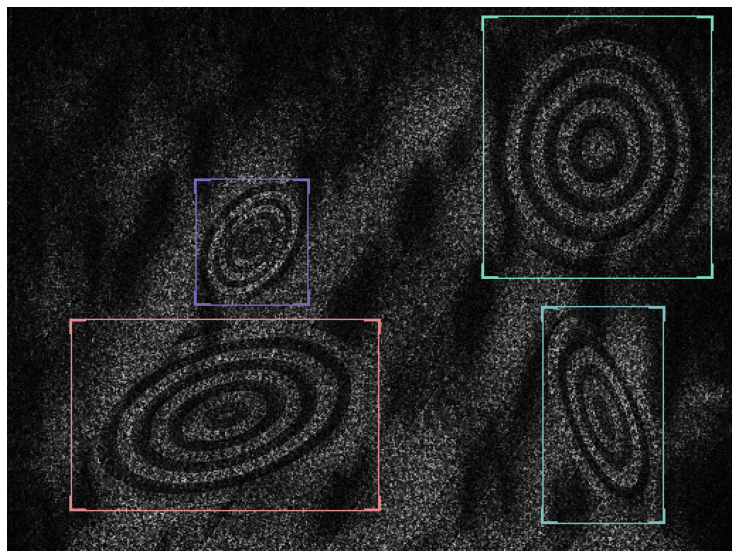

In [19]:
show_record(train_records[5], display_label=False, figsize=(14, 10))

In [20]:
train_records[0]

BaseRecord

common: 
	- Record ID: 870
	- Image size ImgSize(width=512, height=384)
	- Filepath: /home/shawley/datasets/espiownage-cyclegan/images/steelpan_0040039.png
	- Img: None
detection: 
	- BBoxes: [<BBox (xmin:263, ymin:193, xmax:396, ymax:346)>, <BBox (xmin:128, ymin:68, xmax:411, ymax:113)>, <BBox (xmin:53, ymin:196, xmax:232, ymax:369)>, <BBox (xmin:9, ymin:6, xmax:112, ymax:117)>, <BBox (xmin:97, ymin:124, xmax:384, ymax:185)>]
	- Class Map: <ClassMap: {'background': 0, 'AN': 1}>
	- Labels: [1, 1, 1, 1, 1]

## Moving On...
*Following the Getting Started "refrigerator" notebook...*

In [21]:
# Transforms
# size is set to 384 because EfficientDet requires its inputs to be divisible by 128
image_size = 384  
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

# Datasets
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

### this next cell generates an error. ignore it and move on

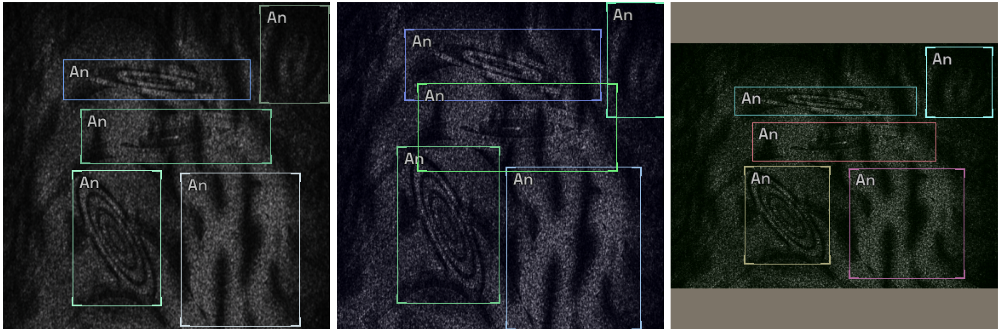

In [22]:
# Show an element of the train_ds with augmentation transformations applied
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

In [23]:
model_type = models.mmdet.retinanet
backbone = model_type.backbones.resnet50_fpn_1x(pretrained=True)

In [24]:
# Just change the value of selection to try another model

selection = 1


extra_args = {}

if selection == 0:
  model_type = models.mmdet.retinanet
  backbone = model_type.backbones.resnet50_fpn_1x

elif selection == 1:
  # The Retinanet model is also implemented in the torchvision library
  model_type = models.torchvision.retinanet
  backbone = model_type.backbones.resnet50_fpn

elif selection == 2:
  model_type = models.ross.efficientdet
  backbone = model_type.backbones.tf_lite0
  # The efficientdet model requires an img_size parameter
  extra_args['img_size'] = image_size

elif selection == 3:
  model_type = models.ultralytics.yolov5
  backbone = model_type.backbones.small
  # The yolov5 model requires an img_size parameter
  extra_args['img_size'] = image_size

model_type, backbone, extra_args

(<module 'icevision.models.torchvision.retinanet' from '/home/shawley/envs/icevision/lib/python3.8/site-packages/icevision/models/torchvision/retinanet/__init__.py'>,
 {})

In [25]:
# Instantiate the mdoel
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), **extra_args) 

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /home/shawley/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [26]:
# Data Loaders
train_dl = model_type.train_dl(train_ds, batch_size=8, num_workers=4, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=8, num_workers=4, shuffle=False)

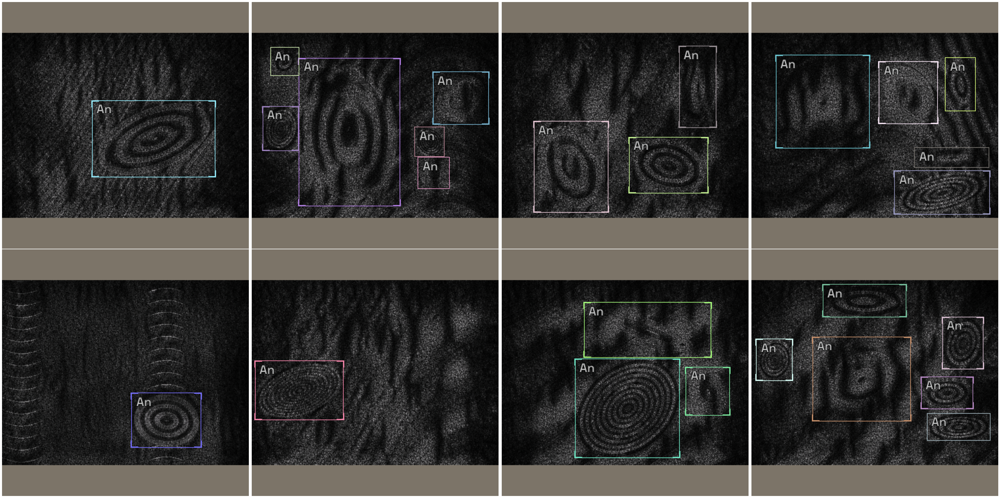

In [27]:
# show batch - target data
model_type.show_batch(first(valid_dl), ncols=4)

In [33]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

In [34]:
# use the fastai bindings
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, metrics=metrics)

SuggestedLRs(lr_min=2.7542287716642023e-05, lr_steep=7.585775892948732e-05)

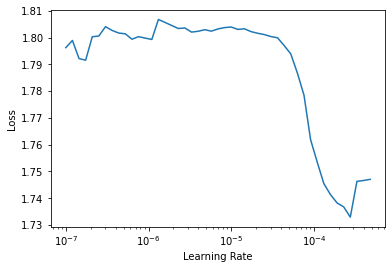

In [35]:
learn.lr_find(end_lr=0.005)

# For Sparse-RCNN, use lower `end_lr`
# learn.lr_find(end_lr=0.005)

In [36]:
learn.fine_tune(60, 1e-4, freeze_epochs=2)

epoch,train_loss,valid_loss,COCOMetric,time
0,1.382472,1.138447,0.014189,00:24
1,0.995744,0.985307,0.090372,00:23


epoch,train_loss,valid_loss,COCOMetric,time
0,0.766973,0.737682,0.266701,00:33
1,0.704099,0.664647,0.345390,00:33
2,0.641785,0.597058,0.410615,00:33
3,0.588479,0.552740,0.439253,00:33
4,0.553743,0.534752,0.484354,00:33
5,0.528012,0.492559,0.502902,00:32
6,0.496259,0.467164,0.507011,00:32
7,0.468638,0.433915,0.542065,00:32
8,0.448554,0.413170,0.579916,00:32
9,0.434068,0.412798,0.551295,00:32


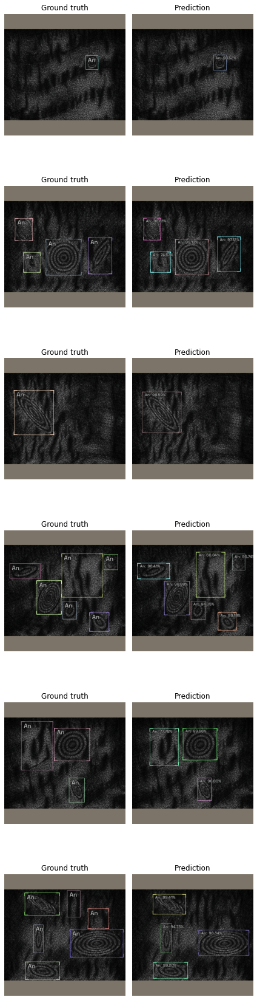

In [37]:
model_type.show_results(model, valid_ds, detection_threshold=.5)

## Inference

In [43]:
preds = model_type.predict(model, valid_ds, keep_images=True)

TypeError: predict() got an unexpected keyword argument 'with_loss'

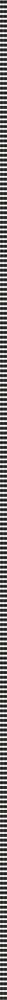

In [39]:
show_preds(preds=preds[0:10])

In [44]:
len(train_ds), len(valid_ds), len(preds)

(832, 209, 209)

let's try to figure out how to get what we want from these predictions.  hmmm

In [85]:
preds[0].pred

BaseRecord

common: 
	- Img: 384x384x3 <np.ndarray> Image
	- Record ID: 539
	- Image size ImgSize(width=384, height=384)
detection: 
	- Class Map: <ClassMap: {'background': 0, 'AN': 1}>
	- Labels: [1]
	- Scores: [0.9868553]
	- BBoxes: [<BBox (xmin:142.2591094970703, ymin:156.2466278076172, xmax:333.04168701171875, ymax:267.3779602050781)>]

In [87]:
preds[0].pred.detection.scores

array([0.9868553], dtype=float32)

In [88]:
preds[0].pred.detection.bboxes

[<BBox (xmin:142.2591094970703, ymin:156.2466278076172, xmax:333.04168701171875, ymax:267.3779602050781)>]

In [93]:
preds[0].pred.detection.bboxes[0].xmin

def get_bblist(pred):
    my_bblist = []
    bblist = pred.pred.detection.bboxes
    for i in range(len(bblist)):
        my_bblist.append([bblist[i].xmin, bblist[i].ymin, bblist[i].xmax, bblist[i].ymax])
    return my_bblist

get_bblist(preds[0])      

[[142.25911, 156.24663, 333.0417, 267.37796]]

In [98]:
results = []
for i in range(len(preds)):
    #print(f"i = {i}, file = {str(Path(valid_ds[i].common.filepath).stem)+'.csv'}, bboxes = {get_bblist(preds[i])}, scores={preds[i].pred.detection.scores}\n")
    worst_score = np.min(np.array(preds[i].pred.detection.scores))
    line_list = [str(Path(valid_ds[i].common.filepath).stem)+'.csv', get_bblist(preds[i]), preds[i].pred.detection.scores, worst_score, i]
    results.append(line_list)
    
# store as pandas dataframe
res_df = pd.DataFrame(results, columns=['filename', 'bblist','scores','worst_score','i'])
res_df = res_df.sort_values('worst_score')  # order by worst score as a "top losses" kind of thing
res_df.head() # take a look

,filename,bblist,scores,worst_score,i
12,steelpan_0000029.csv,"[[42.684723, 187.99416, 183.18018, 268.6339], [191.2504, 75.9324, 323.02982, 229.93192], [68.3033, 67.521286, 170.44449, 165.69962], [51.211563, 267.44662, 249.46263, 322.21536], [33.59114, 206.9505, 212.26224, 289.34067]]","[0.9714665, 0.9657926, 0.7204041, 0.70633274, 0.5111434]",0.511143,12
189,steelpan_0000904.csv,"[[200.8158, 174.86542, 281.0075, 250.05515], [234.00565, 75.93068, 330.38516, 176.80026], [85.0496, 183.49402, 189.56403, 333.149], [64.77986, 52.04474, 238.72475, 127.76965], [14.119356, 103.22791, 48.50573, 148.12149]]","[0.9960259, 0.992378, 0.99137294, 0.912177, 0.511592]",0.511592,189
66,steelpan_0000049.csv,"[[15.12051, 118.76639, 70.77783, 183.96085], [248.91342, 105.94249, 336.9633, 247.08269], [293.78885, 264.37354, 336.80228, 308.43597], [142.19037, 184.63148, 180.11258, 227.51576]]","[0.9898268, 0.9850744, 0.95944643, 0.5253186]",0.525319,66
47,steelpan_0000888.csv,"[[294.75272, 53.51385, 366.92, 116.89061], [229.65038, 95.167015, 287.82156, 189.70688], [82.16948, 205.09933, 121.94702, 250.89099], [158.75662, 223.72386, 324.54315, 322.34283], [50.855408, 113.68904, 192.70499, 194.04472]]","[0.9938643, 0.99187475, 0.9840629, 0.9813324, 0.5274254]",0.527425,47
151,steelpan_0000784.csv,"[[17.847351, 52.1698, 67.796936, 101.52548], [227.98306, 78.69093, 316.62363, 199.97267], [6.6651897, 184.91397, 68.176956, 242.81845], [166.20135, 257.3072, 276.95096, 315.14948], [267.2783, 269.17236, 326.0624, 326.73273], [114.752144, 116.17899, 157.22328, 320.7459]]","[0.98965514, 0.9828661, 0.9827445, 0.83460915, 0.7973198, 0.5497492]",0.549749,151


In [99]:
res_df.to_csv('bboxes_top_losses_cg.csv', index=False)

Reminder: which computer did we run this on?? lol 

In [100]:
!hostname

lecun
